In [ ]:
#0. Descarga del dataset
import gdown
import zipfile

#Descargamos el zip de la URL de descarga directa
URL_drive = "https://drive.google.com/uc?id=1gN3-zFuHqeOgw9kunAZoN4NBlTQWqlnr"
nombre_archivo = "dataset.zip"
gdown.download(URL_drive, nombre_archivo, quiet=False)

#Extraemos en la capeta content de colab
with zipfile.ZipFile('/content/dataset.zip', 'r') as zip_ref:
    zip_ref.extractall('/content/')

# Verificamos el contenido extraído
!ls /content/

Downloading...
From (original): https://drive.google.com/uc?id=1gN3-zFuHqeOgw9kunAZoN4NBlTQWqlnr
From (redirected): https://drive.google.com/uc?id=1gN3-zFuHqeOgw9kunAZoN4NBlTQWqlnr&confirm=t&uuid=04b6bc9e-f12e-480a-b2b7-90521e0d1723
To: /content/dataset.zip
100%|██████████| 227M/227M [00:01<00:00, 136MB/s]


dataset  dataset.zip  sample_data


In [ ]:
#1. Clonamos el modelo YoloV5 e instalamos sus requerimientos
!git clone https://github.com/ultralytics/yolov5
%cd yolov5
!pip install -r requirements.txt


fatal: destination path 'yolov5' already exists and is not an empty directory.
/content/yolov5


In [ ]:
#2. Probamos el modelo con las imagenes propias del modelo
!python detect.py --weights yolov5s.pt --img 640 --conf 0.25 --source data/images/


detect: weights=['yolov5s.pt'], source=data/images/, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-331-gab364c98 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)

100% 14.1M/14.1M [00:00<00:00, 334MB/s]

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/2 /content/yolov5/data/images/bus.jpg: 640x480 4 persons, 1 bus, 52.7ms
image 2/2 /content/yolov5/data/images/zidane.jpg: 384x640 2 persons, 2 ties, 51.1ms
Speed: 0.6ms pre-process, 51.9ms inference, 374.8ms NMS per image at shape (1, 3, 640, 640)
Results saved t

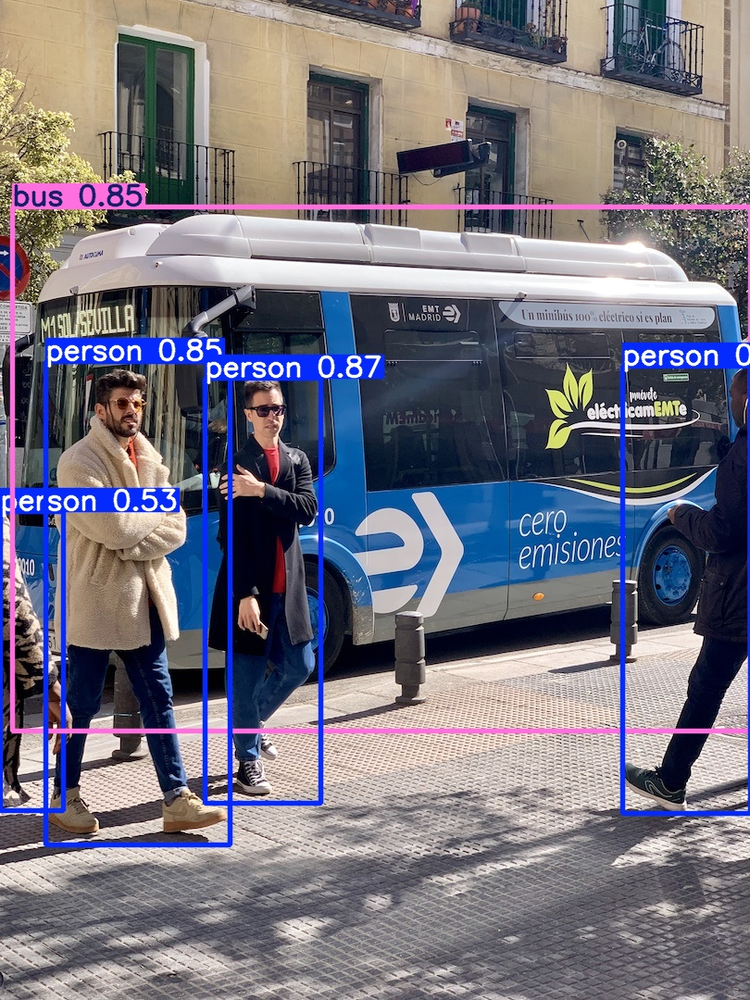

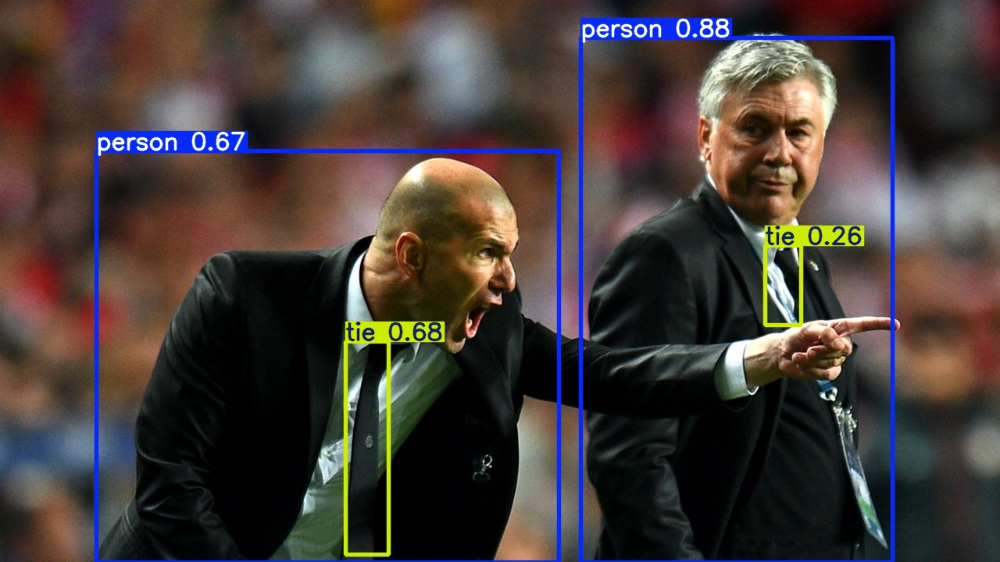

In [ ]:
#3.Mostramos el funcionamiento del modelo
import glob
from IPython.display import Image, display

result_images = glob.glob('runs/detect/exp/*.jpg')  # Ajusta el directorio si es necesario

for image_path in result_images:
    display(Image(filename=image_path))


In [ ]:
#4. Probamos el modelo con las armas
import os
import requests

# Crear el directorio para las imágenes
os.makedirs('data/images', exist_ok=True)

# Lista de URLs de imágenes
image_urls = [
    'https://phantom-elmundo.unidadeditorial.es/6a5bc8ab10babf3e6d6c5cfc92fb3f6d/crop/0x63/2044x1425/resize/1200/f/webp/assets/multimedia/imagenes/2020/03/21/15848016103533.jpg',
    'https://i0.wp.com/www.ruil.cl/wp-content/uploads/2019/12/IMG_20191229_213351.jpg?fit=640%2C427',
    'https://www.lavanguardia.com/files/og_thumbnail/uploads/2013/01/20/5f9b1c5d8f213.jpeg'
    # Añade más URLs de imágenes aquí
]

# Descargar las imágenes
for i, url in enumerate(image_urls):
    try:
        response = requests.get(url)
        response.raise_for_status()  # Verificar si la solicitud fue exitosa
        with open(f'data/images/image_{i}.jpg', 'wb') as f:
            f.write(response.content)
        print(f'Imagen {i} descargada con éxito: {url}')
    except requests.exceptions.RequestException as e:
        print(f'Error al descargar la imagen {i}: {e}')

# Realizar detección en las imágenes descargadas
!python detect.py --weights yolov5s.pt --img 640 --conf 0.25 --source data/images/

Imagen 0 descargada con éxito: https://phantom-elmundo.unidadeditorial.es/6a5bc8ab10babf3e6d6c5cfc92fb3f6d/crop/0x63/2044x1425/resize/1200/f/webp/assets/multimedia/imagenes/2020/03/21/15848016103533.jpg
Imagen 1 descargada con éxito: https://i0.wp.com/www.ruil.cl/wp-content/uploads/2019/12/IMG_20191229_213351.jpg?fit=640%2C427
Imagen 2 descargada con éxito: https://www.lavanguardia.com/files/og_thumbnail/uploads/2013/01/20/5f9b1c5d8f213.jpeg
detect: weights=['yolov5s.pt'], source=data/images/, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-331-gab364c98 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)



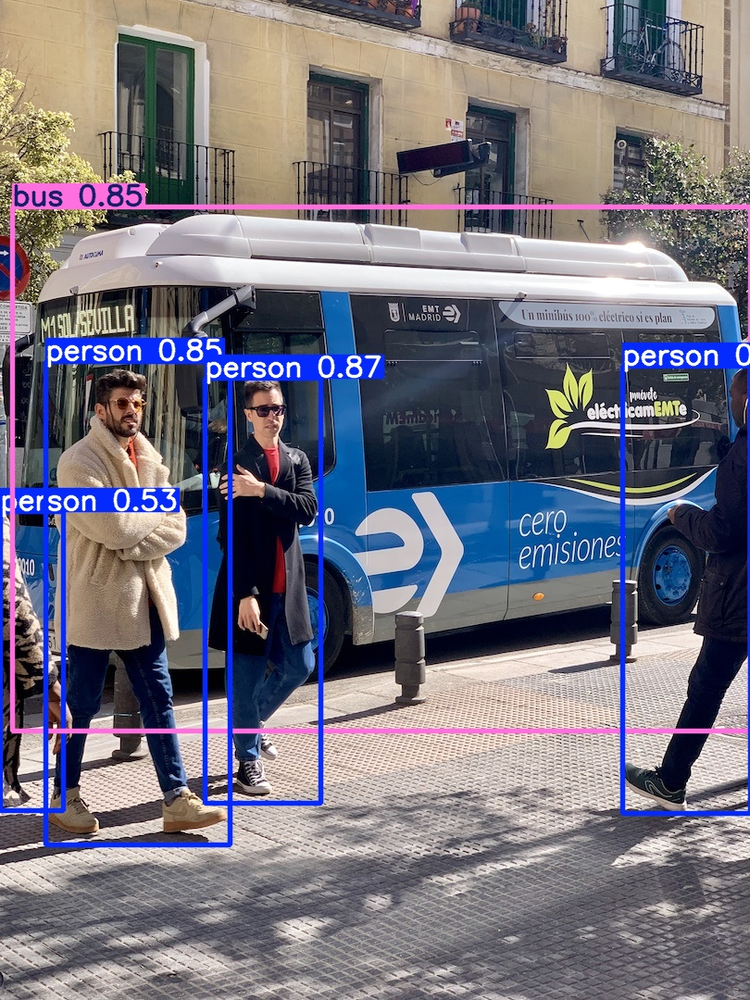

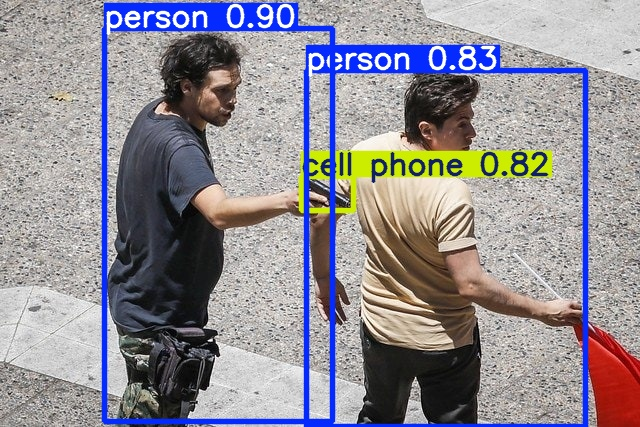

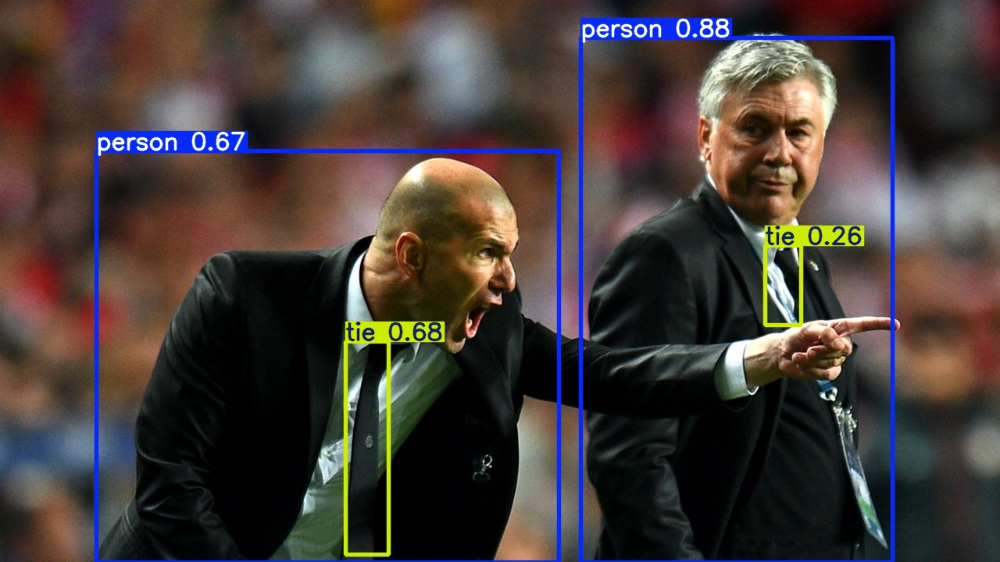

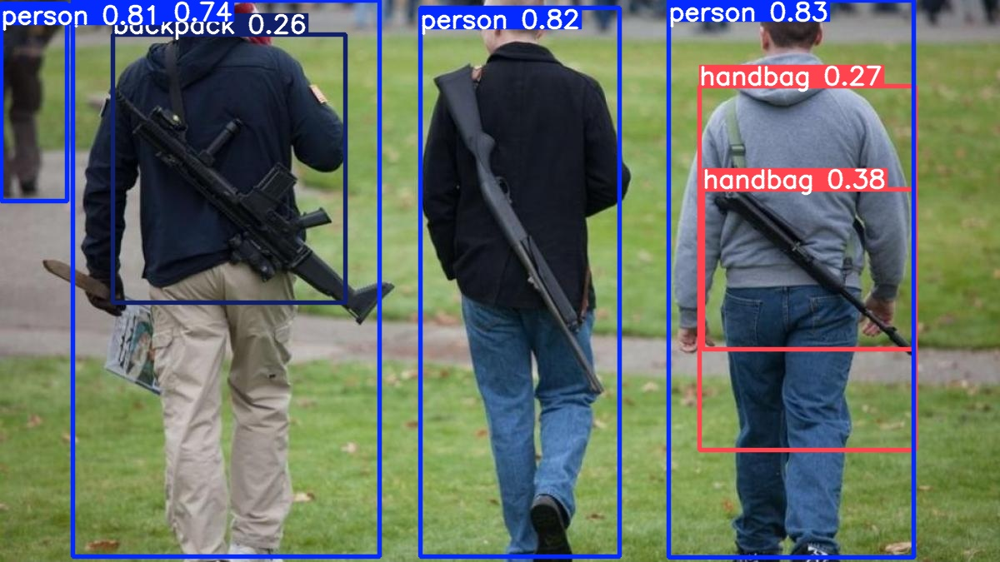

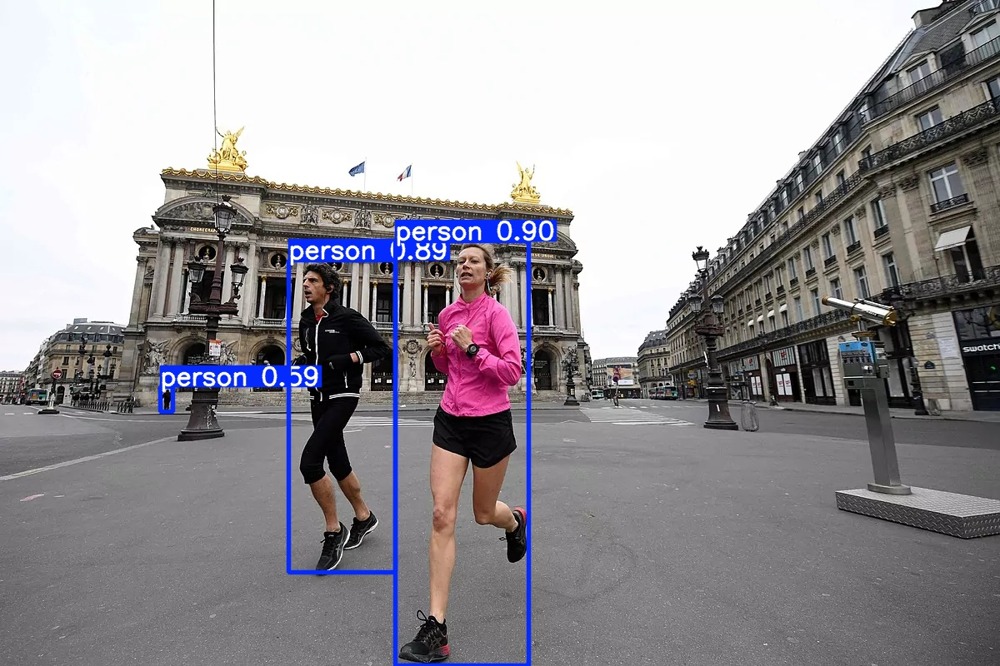

In [ ]:
#5.Visualizar las predicciones
import glob
from IPython.display import Image, display

# Obtener la lista de imágenes resultantes
result_images = glob.glob('runs/detect/exp2/*.jpg')  # Ajustar el directorio si es necesario

# Mostrar las imágenes con predicciones
for image_path in result_images:
    display(Image(filename=image_path))


##Entrenamiento del modelo YoloV5s con armas

In [ ]:
#6. Movemos la data de entrenamiento y validacion a las carpetas de yoloV5
import os
import shutil
from PIL import Image
import numpy as np

# Ruta donde se encuentran los datos extraidos
data_path = '/content/dataset'

# Dirección donde moveremos las carpetas train y test dentro de yolov5 train
images_train_dir = '/content/yolov5/data/images/train'
images_val_dir = '/content/yolov5/data/images/val'


# Mover las imágenes de entrenamiento
shutil.move(os.path.join(data_path, 'images', 'train'), images_train_dir)

# Mover las imágenes de validación
shutil.move(os.path.join(data_path, 'images', 'val'), images_val_dir)

# Mover etiquetas a las carpetas correctas (train y val)
labels_train_dir = '/content/yolov5/data/labels/train'
labels_val_dir = '/content/yolov5/data/labels/val'


# Mover las etiquetas de entrenamiento
shutil.move(os.path.join(data_path, 'labels', 'train'), labels_train_dir)

# Mover las etiquetas de validación
shutil.move(os.path.join(data_path, 'labels', 'val'), labels_val_dir)



'/content/yolov5/data/labels/val'

In [ ]:
#7. Creamos el dataset con los nombre de las clases a predecir
dataset_yaml = """
train: ../data/images/train
val: ../data/images/val

nc: 2  # Número total de clases
names: ['Cuchillo', 'Arma de fuego']  # Nombres de las clases
"""

with open('dataset.yaml', 'w') as f:
    f.write(dataset_yaml)


In [ ]:
#8. Entrenamos el modelo con imagenes tamaño 640X640, con 30 epocas con tamaño de lote 8, usando el dataset creado previamente y el modelo pre entrenado yolov5s
!python train.py --img 640 --batch 8 --epochs 30 --data dataset.yaml --weights yolov5s.pt

2024-06-26 01:40:54.350797: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-06-26 01:40:54.350852: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-06-26 01:40:54.467046: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=yolov5s.pt, cfg=, data=dataset.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=30, batch_size=8, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, evolve_population=data/hyps, resume_evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, opt

In [ ]:
#9. Montamos nuestro drive en colab
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#10. Copiamos los pesos del modelo entrenado para usarlo posteriormente en los datos de validacion
!cp runs/train/exp/weights/*.pt /content/drive/MyDrive/yolov5_weightsV2

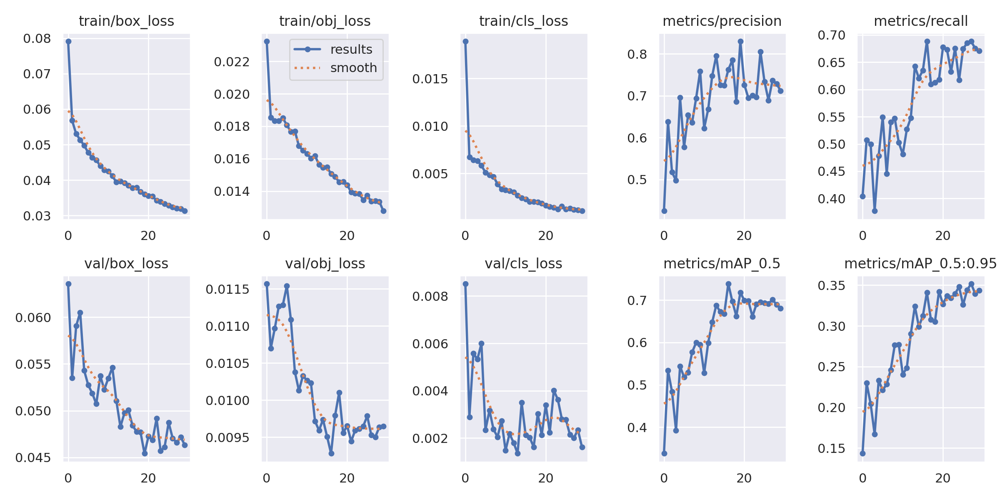

In [ ]:
#11. Mostramos los resultados de la perdida, precision y recall
from IPython.display import Image, display
Image(filename="runs/train/exp/results.png")

In [ ]:
#12. Realizamos detección en las imágenes de validación
!python detect.py --weights runs/train/exp/weights/best.pt --img 640 --conf 0.25 --source /content/yolov5/data/images/val


detect: weights=['runs/train/exp/weights/best.pt'], source=/content/yolov5/data/images/val, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-331-gab364c98 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs
WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/156 /content/yolov5/data/images/val/2001.jpg: 448x640 1 Arma de fuego, 46.3ms
image 2/156 /content/yolov5/data/images/val/2002.jpg: 640x416 1 Arma de fuego, 62.4ms
image 3/156 /content/yolov5/data/images/val/2003.jpg: 640x448 1 Arma de fuego, 51.0ms
image 4/156 /cont

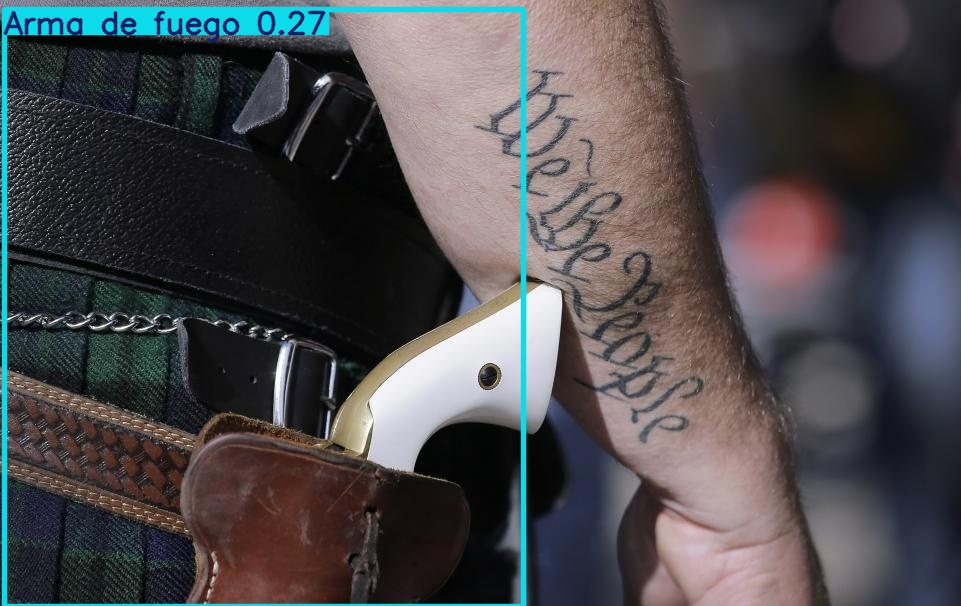

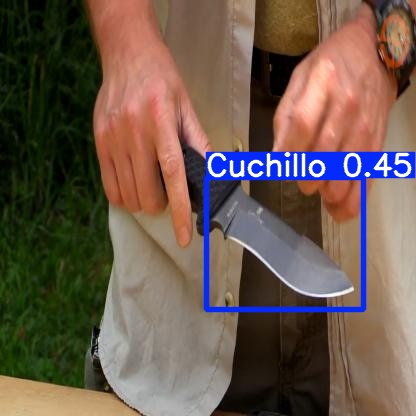

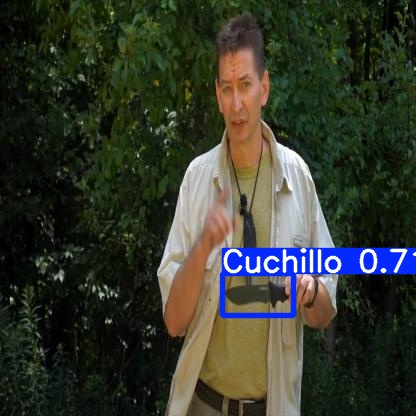

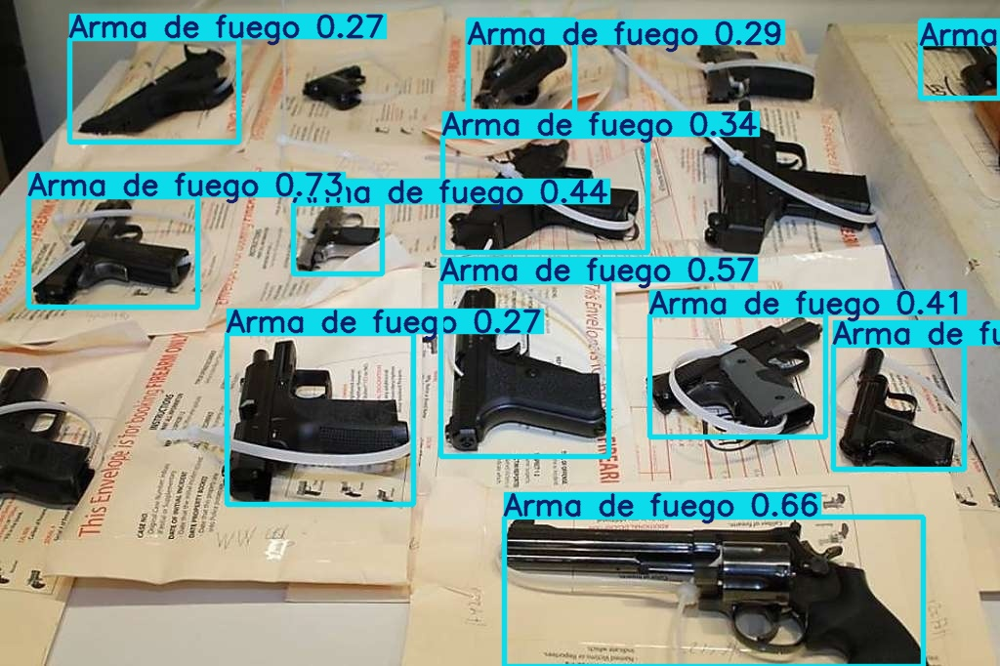

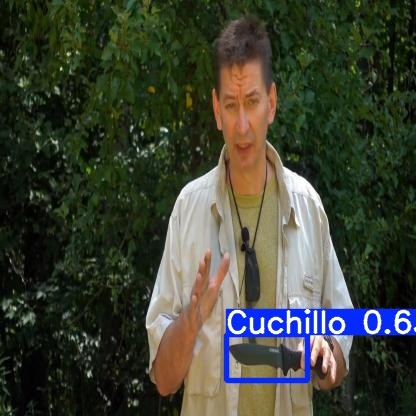

...

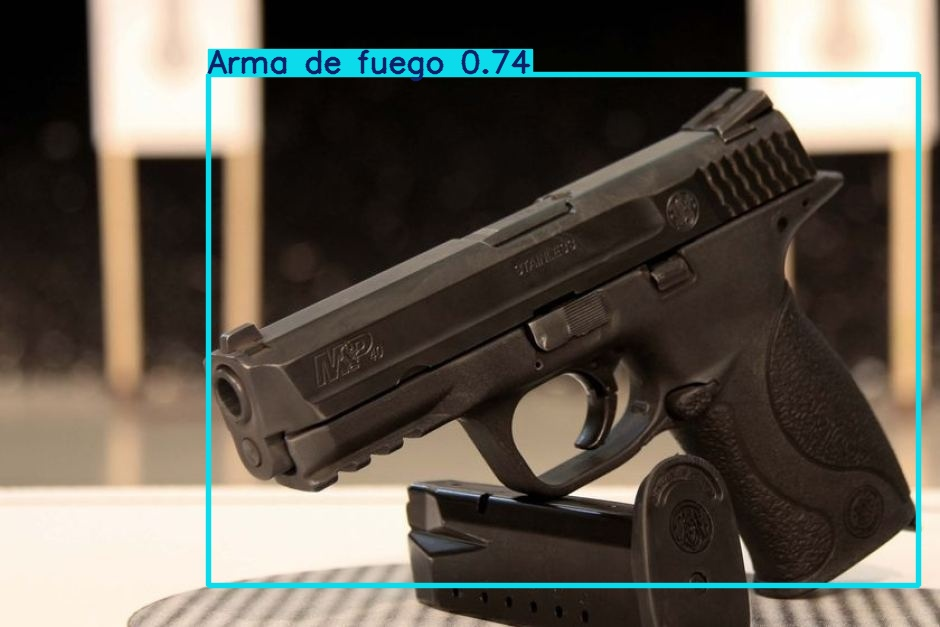

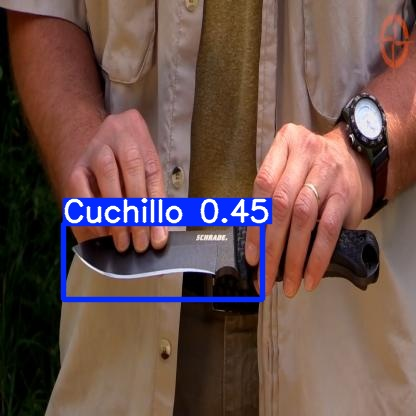

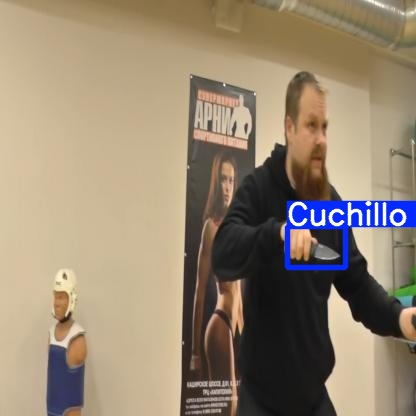

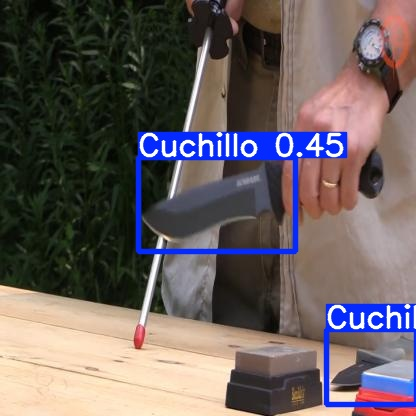

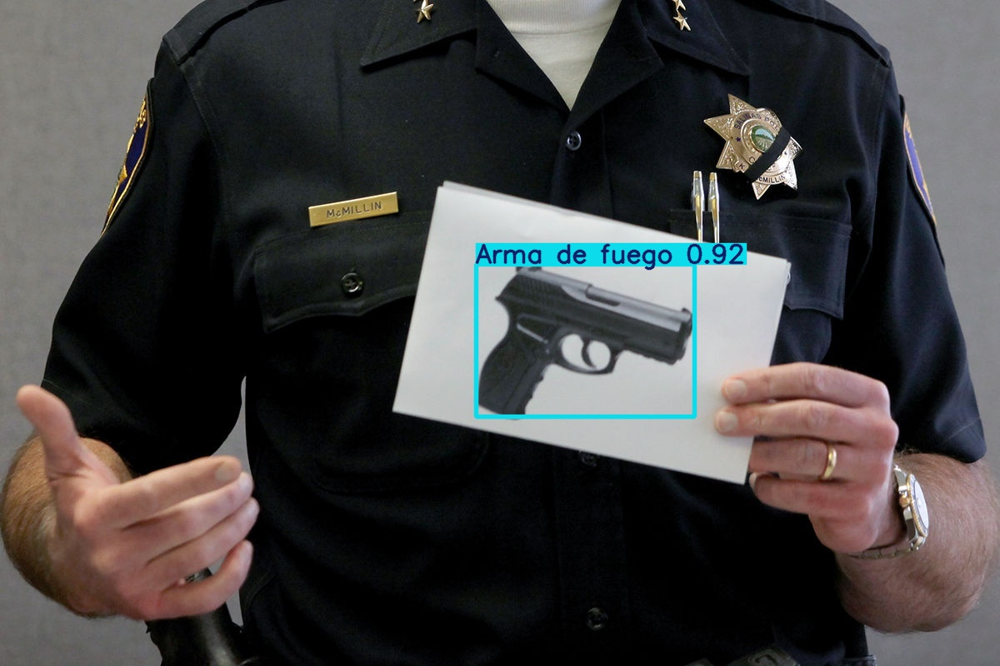

In [ ]:
#13. Muestra las imágenes de validación
import glob
from IPython.display import Image, display

# Obtener la lista de imágenes resultantes
result_images = glob.glob('runs/detect/exp3/*.jpg') # Ajusta el directorio si es necesario

# Mostrar las imágenes con predicciones
for image_path in result_images:
    display(Image(filename=image_path))


##Usar modelo en datos de validacion

In [ ]:
!python val.py --weights /content/yolov5/runs/train/exp/weights/best.pt --img 640 --data dataset.yaml


val: data=dataset.yaml, weights=['/content/yolov5/runs/train/exp/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-331-gab364c98 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs
val: Scanning /content/yolov5/data/labels/val.cache... 156 images, 0 backgrounds, 0 corrupt: 100% 156/156 [00:00<?, ?it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 5/5 [00:06<00:00,  1.34s/it]
                   all        156        190      0.734      0.693      0.697      0.349
              Cuchillo        156         90      0.641      0.635      0.614      0.222
         Arma de fuego    

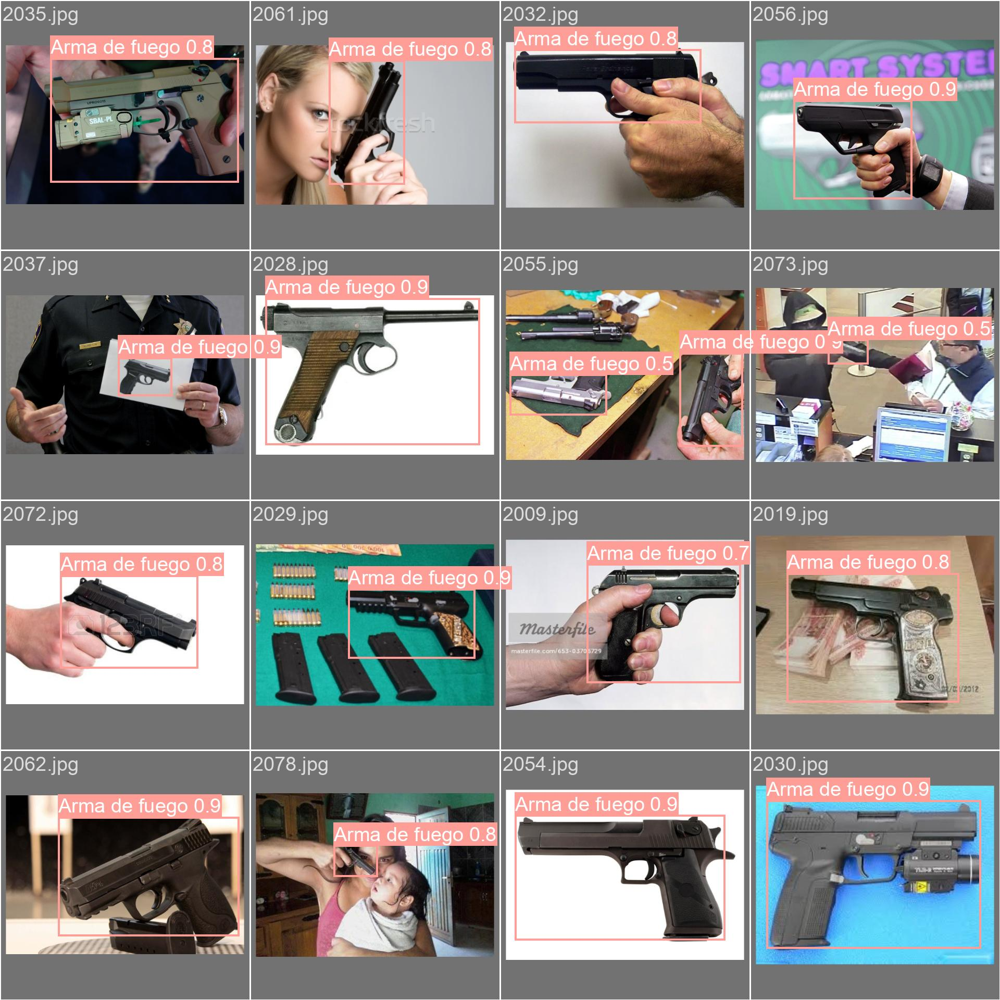

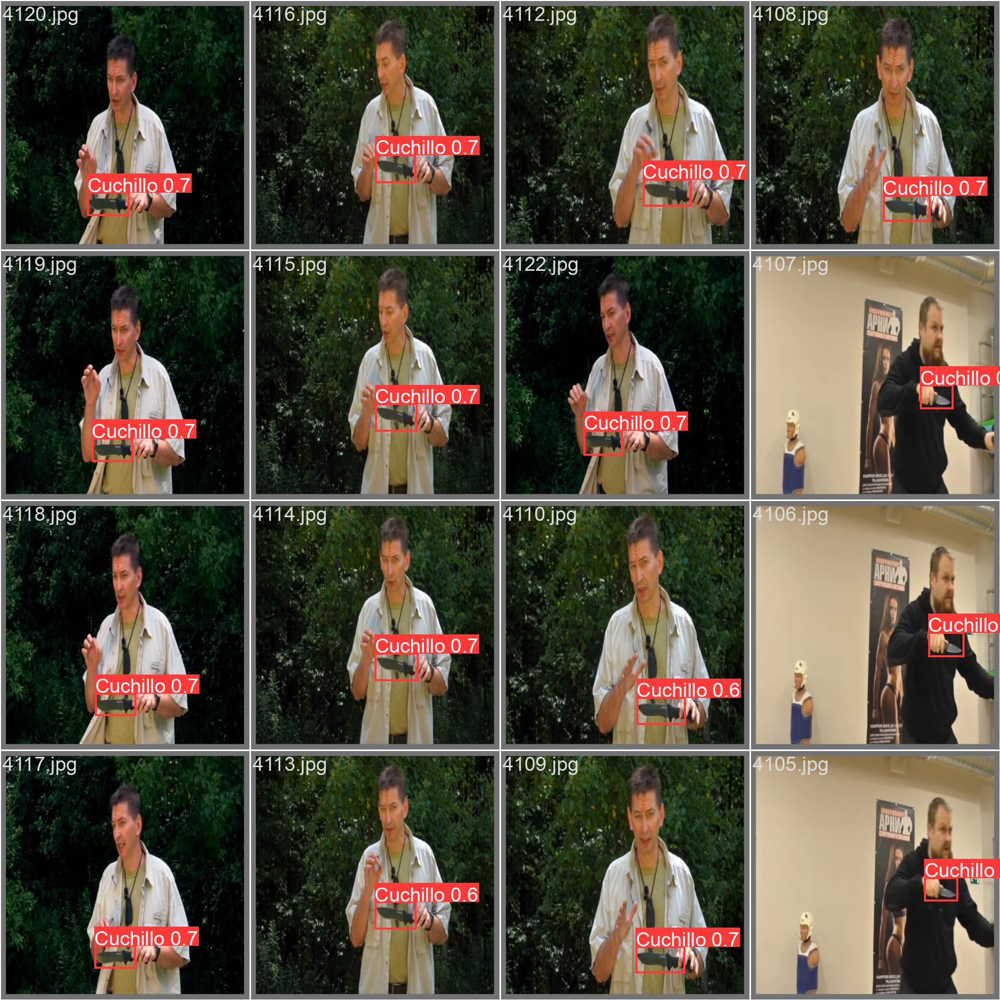

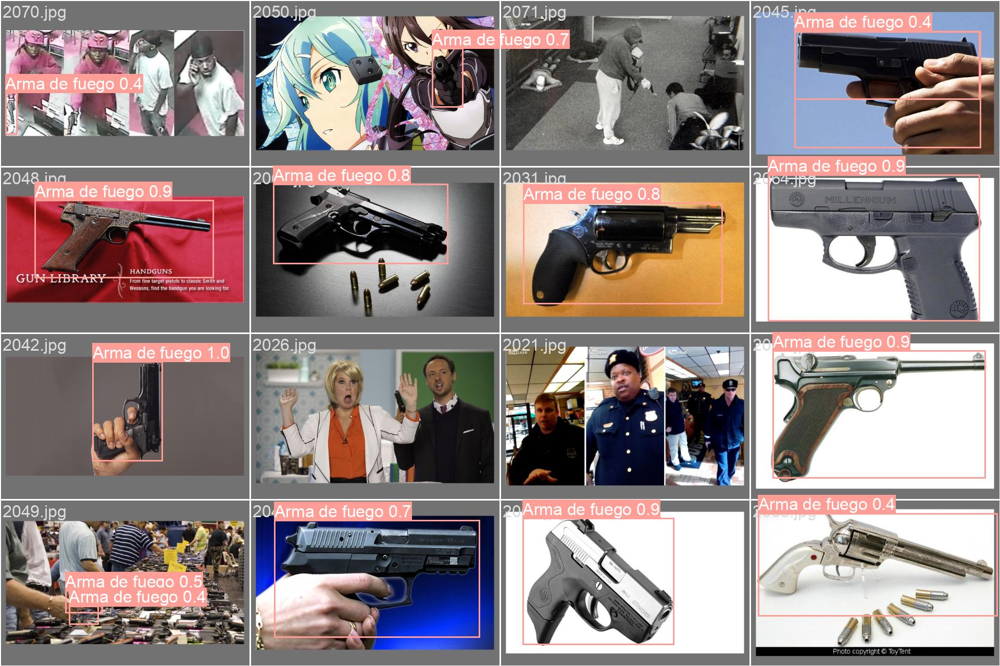

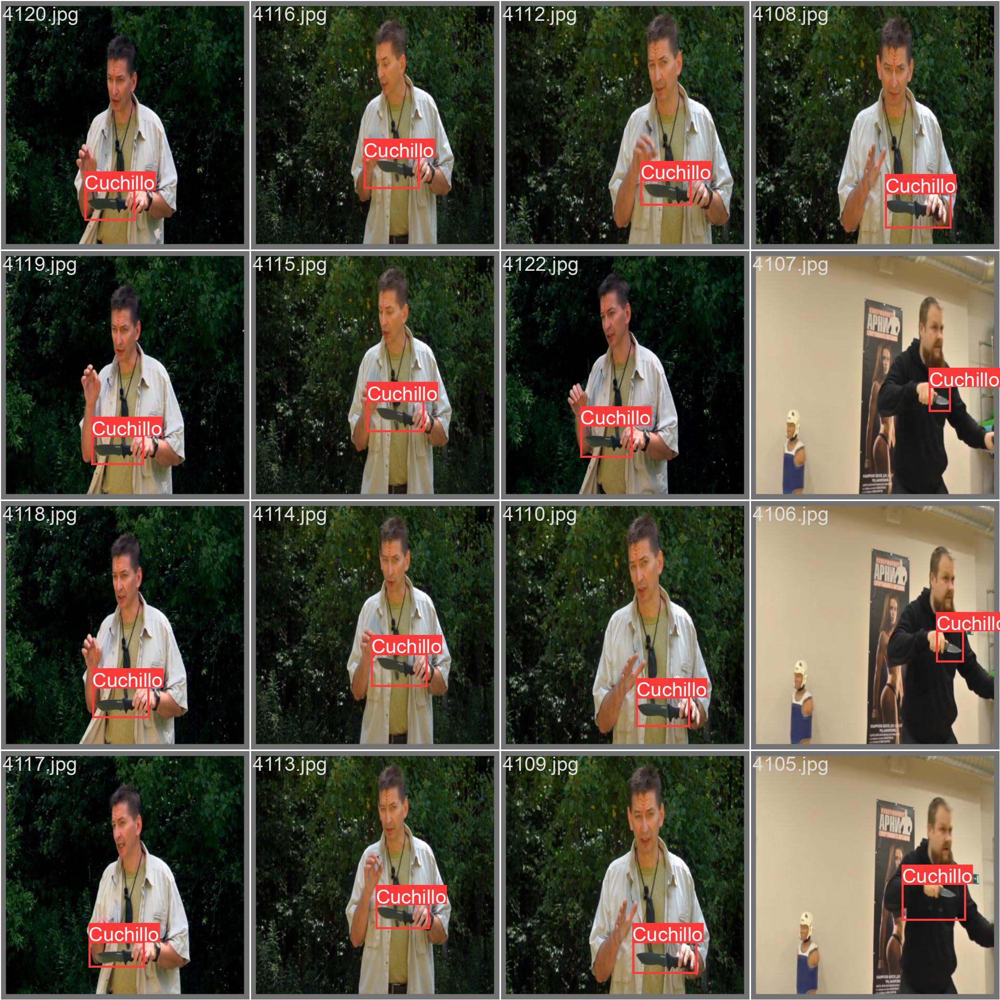

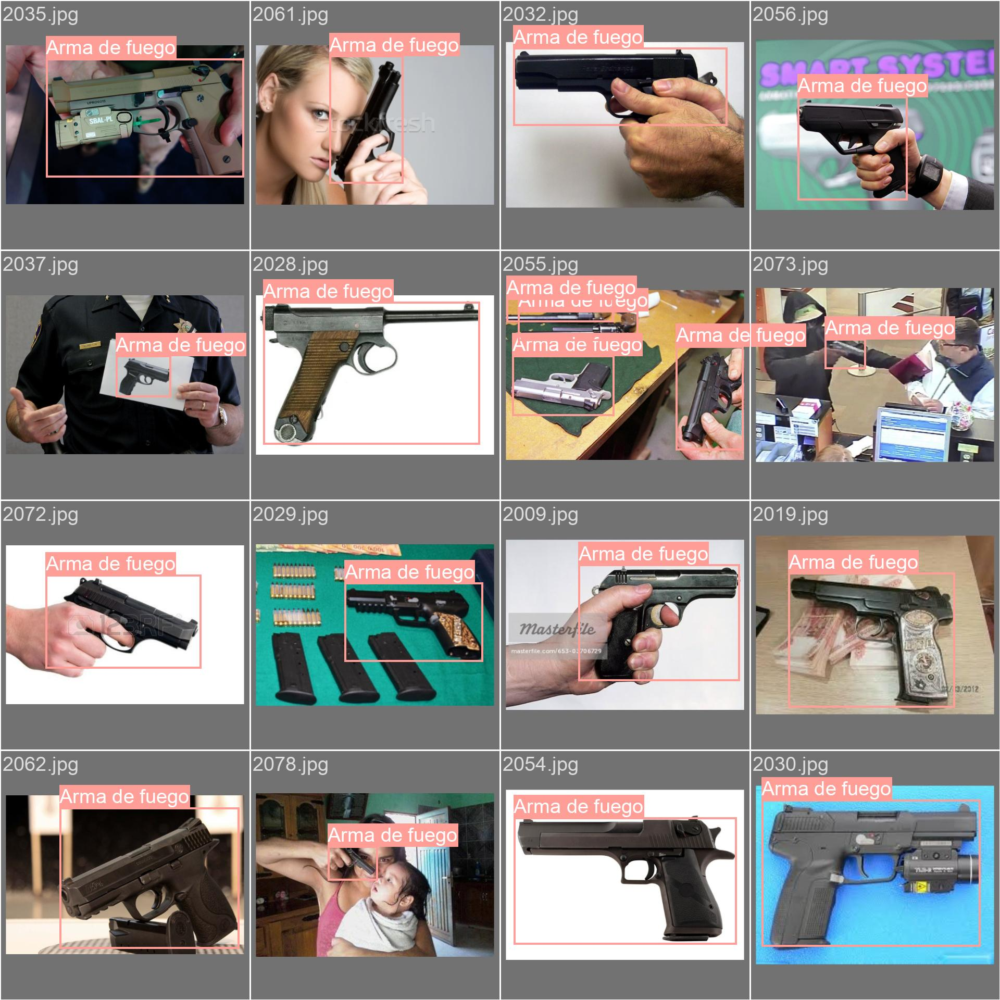

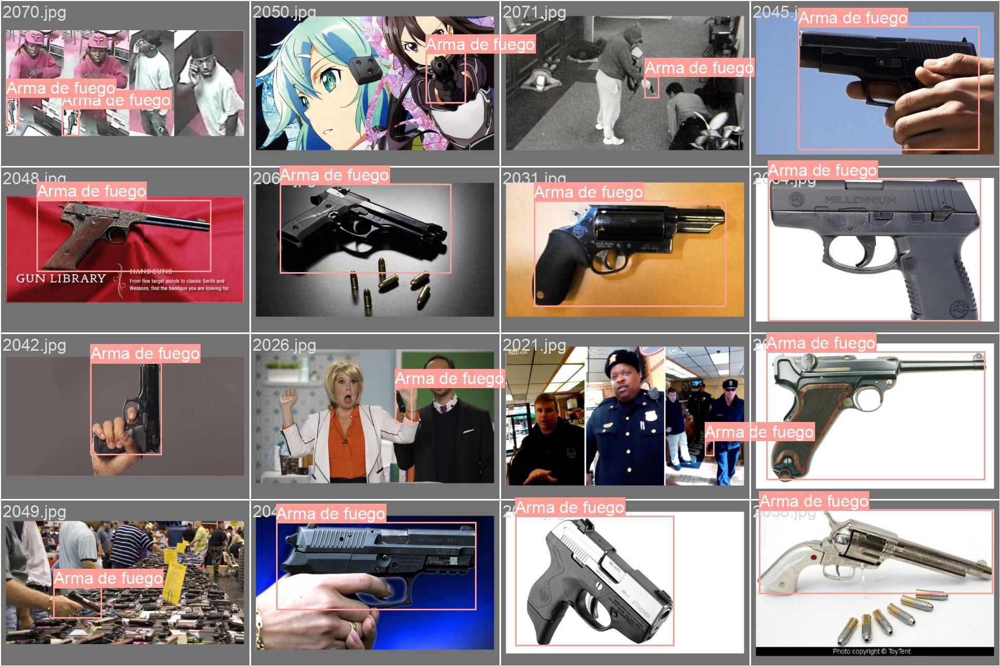

In [ ]:

import glob
from IPython.display import Image, display

# Obtener la lista de imágenes resultantes
result_images = glob.glob('runs/val/exp3/*.jpg') # Ajusta el directorio si es necesario

# Mostrar las imágenes con predicciones
for image_path in result_images:
    display(Image(filename=image_path))


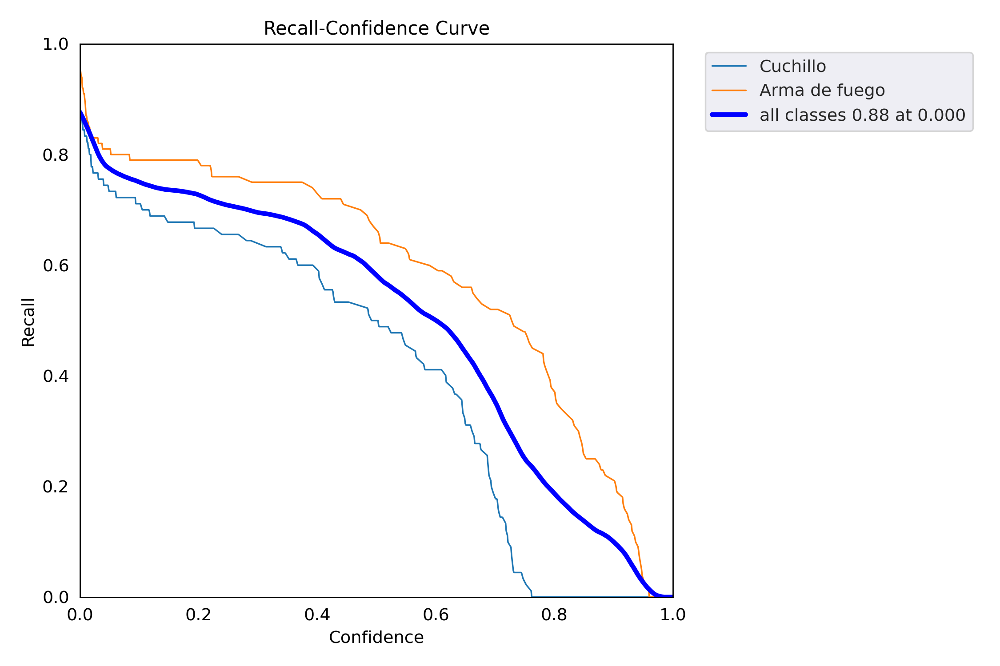

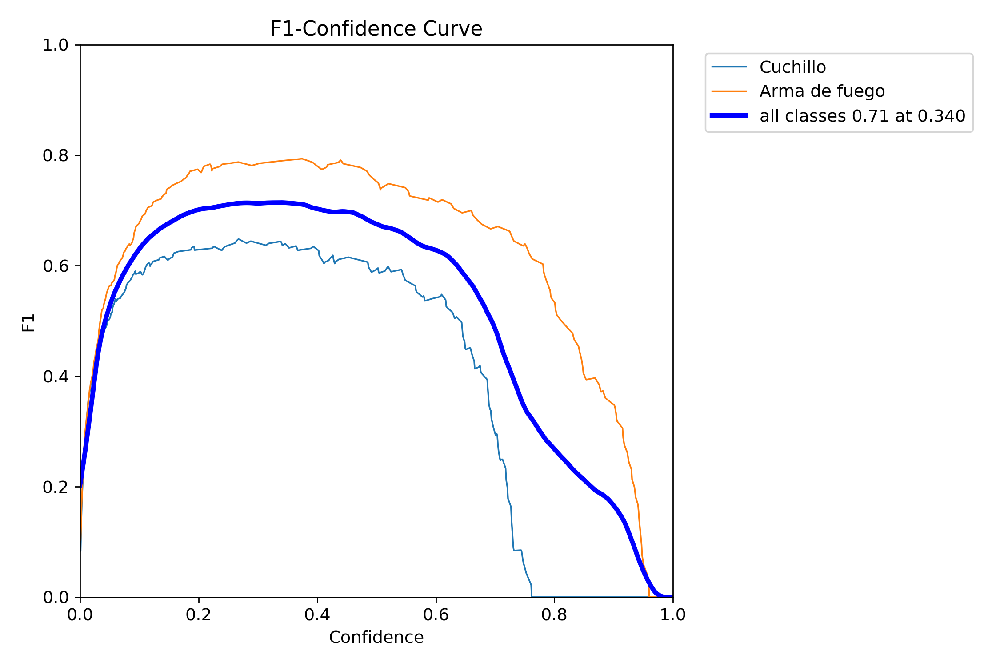

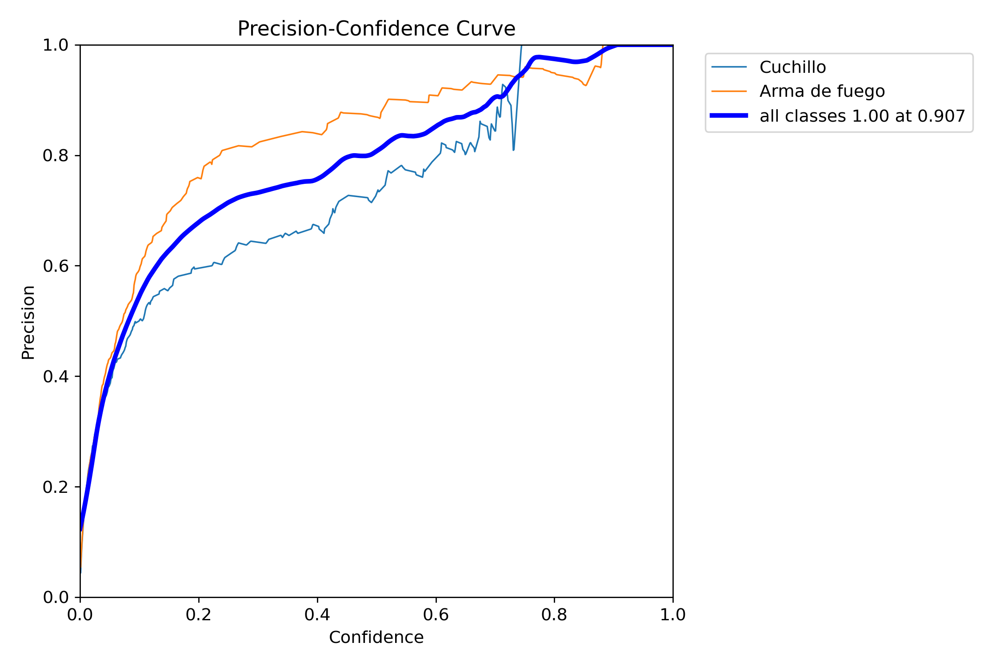

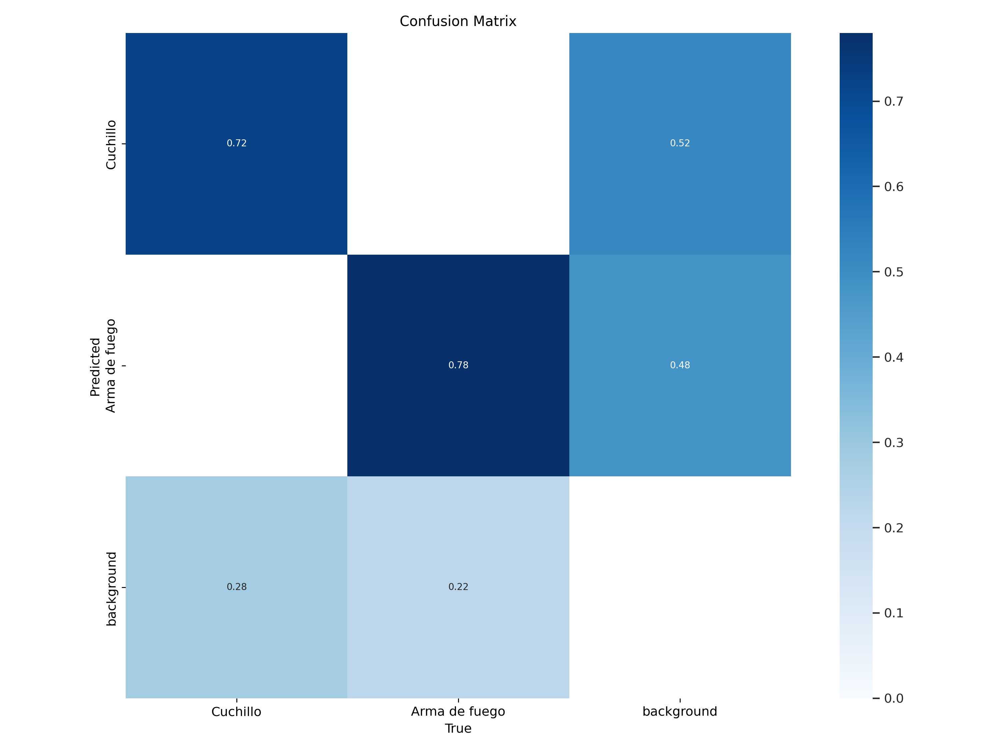

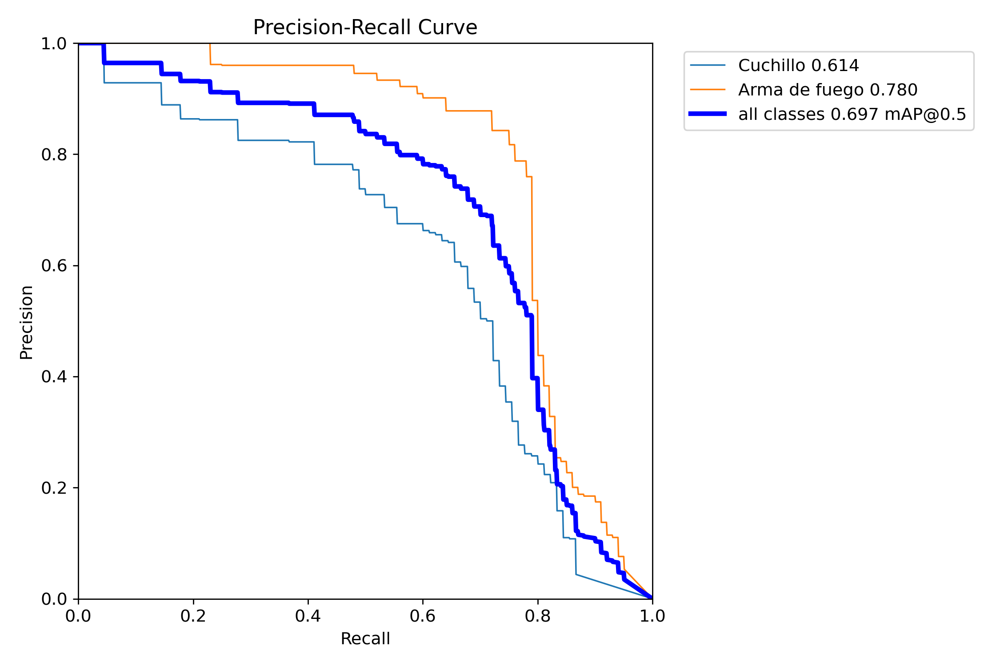

In [ ]:
import glob
from IPython.display import Image, display

# Obtener la lista de imágenes resultantes
result_images = glob.glob('runs/val/exp3/*.png')

# Mostrar las imágenes con predicciones
for image_path in result_images:
    display(Image(filename=image_path))